In [2]:
import pandas as pd
%pip install nbconvert notebook jupyter_server


Note: you may need to restart the kernel to use updated packages.


In [3]:
import csv

input_filename = '/Users/pedropapp/Desktop/coding shit/env/bin/results-2.csv'
output_filename = 'correctly_formatted.csv'

with open(input_filename, 'r', newline='') as input_file:
    reader = csv.reader(input_file, delimiter='|')
    data = list(reader)


In [4]:
with open(output_filename, 'w', newline='') as output_file:
    writer = csv.writer(output_file, delimiter=',')
    writer.writerows(data)

In [5]:
import csv

input_filename = '/Users/pedropapp/Desktop/coding shit/env/bin/results-2.csv'
output_filename = 'correctly_formatted.csv'

with open(input_filename, 'r', newline='') as input_file:
    reader = csv.reader(input_file, delimiter='|')
    data = list(reader)

with open(output_filename, 'w', newline='') as output_file:
    writer = csv.writer(output_file, delimiter=',')
    writer.writerows(data)

In [6]:
from matplotlib.animation import FuncAnimation
df = pd.read_csv("correctly_formatted.csv")

In [7]:
df.sort_values(by="timestamp",ascending=True,inplace=True)
df.reset_index(inplace=True,drop=True)
df.head()


,_id,isPb,wpm,acc,rawWpm,consistency,charStats,mode,mode2,quoteLength,...,punctuation,numbers,language,funbox,difficulty,lazyMode,blindMode,bailedOut,tags,timestamp
0,61719174653e0be59fb312dc,True,32.40,85.98,38.80,59.28,"81,3,0,0",time,30,-1.0,...,False,False,english,none,normal,False,False,False,NaN,1634832757000
1,617191c3653e0be59fb315e6,True,42.80,93.16,42.80,70.88,"107,0,0,0",time,30,-1.0,...,False,False,english,none,normal,False,False,False,NaN,1634832835000
2,61719213653e0be59fb82c47,True,48.80,93.85,48.80,63.61,"122,0,0,0",time,30,-1.0,...,False,False,english,none,normal,False,False,False,NaN,1634832915000
3,61719261653e0be59fb82f75,True,43.26,92.16,43.26,72.69,"46,0,0,0",words,10,-1.0,...,False,False,english,none,normal,False,False,False,NaN,1634832994000
4,617192b3653e0be59fb832a1,True,47.49,91.94,47.49,56.88,"56,0,0,0",words,10,-1.0,...,False,False,english,none,normal,False,False,False,NaN,1634833076000


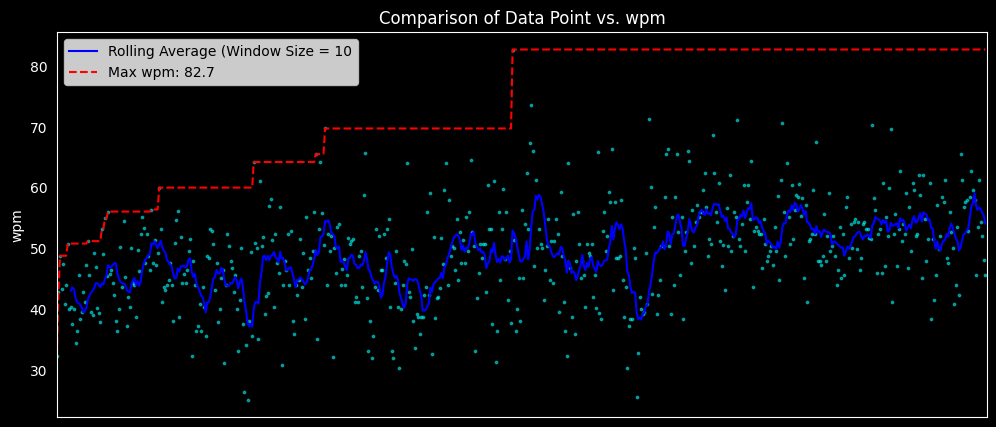

In [8]:
import matplotlib.pyplot as plt
import numpy as np

# Calculate the rolling average
rolling_avg = df["wpm"].rolling(window=10).mean()

# Create the plot
plt.figure(figsize=(12, 5), facecolor='black')  # Increase the figure width
plt.scatter(df.index, df["wpm"], c='cyan', alpha=0.5, s=3)  # Use the index as x-values
plt.plot(df.index, rolling_avg, color='blue', label=f'Rolling Average (Window Size = {10}')
plt.title(f'Comparison of Data Point vs. {"wpm"}', color='white')  # Set the title and text color
plt.ylabel("wpm", color='white')  # Set the y-axis label and text color

# Set the background color of the entire grid to black
plt.gca().set_facecolor('black')

# Set the x-axis limits to range from 0 to 600
plt.xlim(0, 600)

plt.grid(False)  # Set the grid lines to white

plt.xticks([])

# Customize the ticks and spines
plt.xticks(color='white')
plt.yticks(color='white')
for spine in plt.gca().spines.values():
    spine.set_color('white')

# Initialize max wpm variables
max_wpm = df["wpm"][0]
max_wpm_index = 0

# Initialize the horizontal line data
horizontal_line = []

# Iterate through the data to dynamically update the max wpm and horizontal line
for idx, wpm in enumerate(df["wpm"]):
    if wpm > max_wpm:
        max_wpm = wpm
        max_wpm_index = idx
    horizontal_line.append(max_wpm)

# Plot the horizontal line
plt.plot(df.index, horizontal_line, color='red', linestyle='--', label=f'Max wpm: {max_wpm}')

plt.legend()

# Remove data point values in the bottom
plt.tick_params(axis='x', which='both', bottom=False)
plt.show()

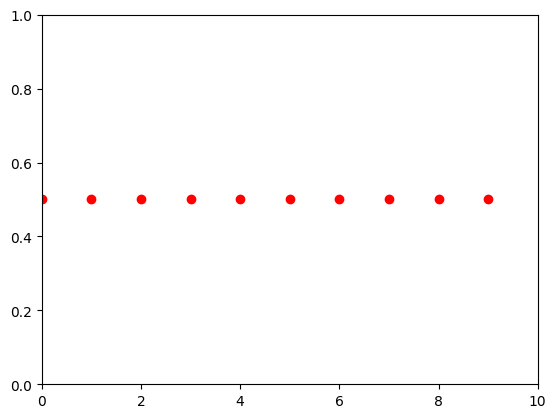

In [9]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

# Create a blank figure and axis
fig, ax = plt.subplots()
xdata, ydata = [], []
ln, = plt.plot([], [], 'ro')

# Set the axis limits
ax.set_xlim(0, 10)
ax.set_ylim(0, 1)

# Initialization function for creating a blank background
def init():
    ln.set_data([], [])
    return ln,

# Animation function to update the plot for each frame
def update(frame):
    xdata.append(frame)
    ydata.append(0.5)  # A simple point at y=0.5
    ln.set_data(xdata, ydata)
    return ln,

# Create the animation
ani = FuncAnimation(fig, update, frames=range(10), init_func=init, blit=True)

# Display the animation in the notebook
HTML(ani.to_jshtml())


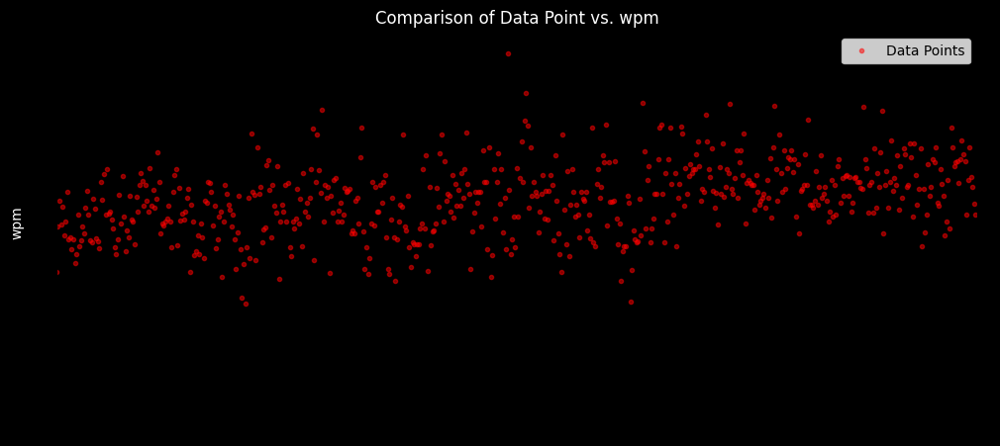

In [10]:
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

# Create a blank figure and axis
fig, ax = plt.subplots(figsize=(12, 5), facecolor='black')
ax.set_xlim(0, 600)
ax.set_ylim(0, df["wpm"].max() + 5)  # Adjust the y-axis limit as needed
ax.set_title(f'Comparison of Data Point vs. {"wpm"}', color='white')
ax.set_ylabel("wpm", color='white')
ax.set_facecolor('black')

# Initialize data points
xdata, ydata = [], []
ln, = ax.plot([], [], 'ro', label='Data Points', markersize=3, alpha=0.5)
ax.legend(loc='upper right')

# Initialization function for creating a blank background
def init():
    ln.set_data([], [])
    return ln,

# Animation function to update the plot for each frame
def update(frame):
    xdata.append(df.index[frame])
    ydata.append(df["wpm"].iloc[frame])
    ln.set_data(xdata, ydata)

    return ln,

# Create the animation
ani = FuncAnimation(fig, update, frames=len(df), init_func=init, blit=True)

# Display the animation in the notebook
HTML(ani.to_jshtml())


In [11]:
%brew install ffmpeg
%pip install Pillow

UsageError: Line magic function `%brew` not found.


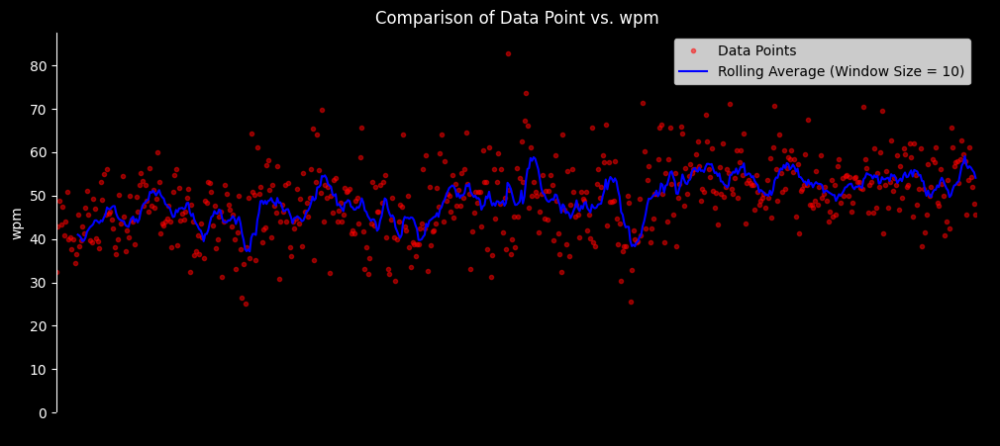

In [12]:

import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML
from PIL import Image

# Create a blank figure and axis
fig, ax = plt.subplots(figsize=(12, 5), facecolor='black')
ax.set_xlim(0, 600)
ax.set_ylim(0, df["wpm"].max() + 5)  # Adjust the y-axis limit as needed
ax.set_title(f'Comparison of Data Point vs. {"wpm"}', color='white')
ax.set_ylabel("wpm", color='white')
ax.set_facecolor('black')

# Add a scale for the wpm axis in white color
ax.yaxis.label.set_color('white')
ax.tick_params(axis='y', colors='white')
ax.spines['left'].set_color('white')

# Initialize data points and rolling average
xdata, ydata = [], []
rolling_avg_data = []
ln, = ax.plot([], [], 'ro', label='Data Points', markersize=3, alpha=0.5)
rolling_avg_ln, = ax.plot([], [], color='blue', label=f'Rolling Average (Window Size = 10)')
ax.legend(loc='upper right')

# Initialization function for creating a blank background
def init():
    ln.set_data([], [])
    rolling_avg_ln.set_data([], [])
    return ln, rolling_avg_ln

# Animation function to update the plot for each frame
def update(frame):
    xdata.append(df.index[frame])
    ydata.append(df["wpm"].iloc[frame])
    ln.set_data(xdata, ydata)

    if len(ydata) >= 15:
        rolling_window = 10
        if len(ydata) >= rolling_window:
            rolling_avg = sum(ydata[-rolling_window:]) / rolling_window
            rolling_avg_data.append(rolling_avg)
        else:
            rolling_avg_data.append(0)

        rolling_avg_ln.set_data(xdata[-len(rolling_avg_data):], rolling_avg_data)

    return ln, rolling_avg_ln
# Create the animation
ani = FuncAnimation(fig, update, frames=len(df), init_func=init, blit=True)


# Define the filename for the GIF
gif_filename = "visuwpm3.gif"

# Save the animation as a GIF
ani.save(gif_filename,fps= 40, writer='pillow')





UnboundLocalError: local variable 'max_wpm' referenced before assignment

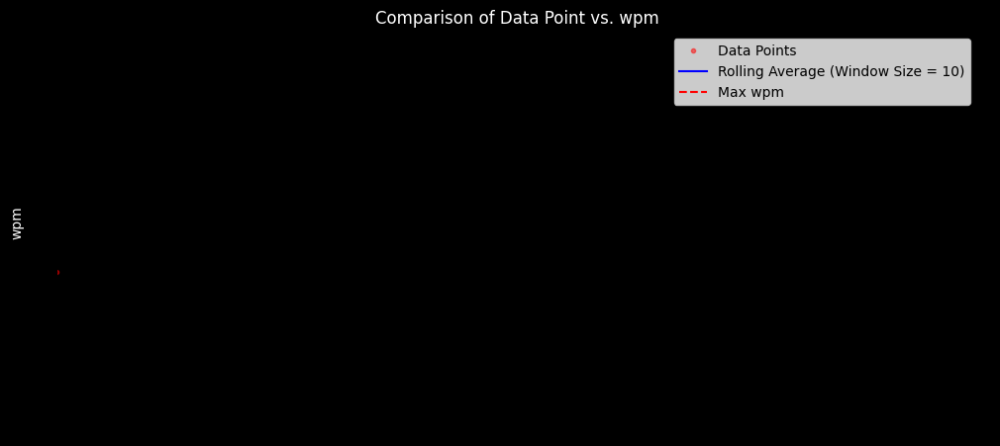

In [13]:
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

# Create a blank figure and axis
fig, ax = plt.subplots(figsize=(12, 5), facecolor='black')
ax.set_xlim(0, 600)
ax.set_ylim(0, df["wpm"].max() + 5)  # Adjust the y-axis limit as needed
ax.set_title(f'Comparison of Data Point vs. {"wpm"}', color='white')
ax.set_ylabel("wpm", color='white')
ax.set_facecolor('black')

# Initialize max wpm variables
max_wpm = df["wpm"].iloc[0]
max_wpm_index = 0
max_wpm_data = [max_wpm]

# Initialize data points and rolling average
xdata, ydata = [], []
rolling_avg_data = []
ln, = ax.plot([], [], 'ro', label='Data Points', markersize=3, alpha=0.5)
rolling_avg_ln, = ax.plot([], [], color='blue', label=f'Rolling Average (Window Size = 10)')
max_wpm_ln, = ax.plot([], [], color='red', label='Max wpm', linestyle='--')
ax.legend(loc='upper right')

# Initialization function for creating a blank background
def init():
    ln.set_data([], [])
    rolling_avg_ln.set_data([], [])
    max_wpm_ln.set_data([], [])
    return ln, rolling_avg_ln, max_wpm_ln

# Animation function to update the plot for each frame
def update(frame):
    xdata.append(df.index[frame])
    ydata.append(df["wpm"].iloc[frame])
    ln.set_data(xdata, ydata)

    if len(ydata) >= 15:
        rolling_window = 10
        if len(ydata) >= rolling_window:
            rolling_avg = sum(ydata[-rolling_window:]) / rolling_window
            rolling_avg_data.append(rolling_avg)
        else:
            rolling_avg_data.append(0)

        rolling_avg_ln.set_data(xdata[-len(rolling_avg_data):], rolling_avg_data)

    # Update max wpm line
    wpm_value = df["wpm"].iloc[frame]
    if wpm_value > max_wpm:
        max_wpm = wpm_value
        max_wpm_index = frame
    max_wpm_data.append(max_wpm)
    max_wpm_ln.set_data(xdata, max_wpm_data)

    return ln, rolling_avg_ln, max_wpm_ln

# Create the animation
ani = FuncAnimation(fig, update, frames=len(df), init_func=init, blit=True)

# Display the animation in the notebook
HTML(ani.to_jshtml())
